# 1: Imports

In [169]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from typing import Any
from IPython.display import HTML
from __future__ import annotations

# 2: Defining Necessary Objects and Associated Functions

## 2.1 Defining Objects

### 2.1.1 Defining Point Object

In [170]:
class Point:
  '''
  Creates a point on the surface.
    - float x: x coordinate
    - float y: y coordinate
    - list[Point] adj: list of adjacent points
    - tuple(float, float) imbal: direction of imbalance of the point
    - bool is_boundary: whether the point is a boundary point
  '''

  def __init__(self, x: float, y:float, is_boundary: bool = False):
    '''
    Constructor for Point
    '''
    self.x = x
    self.y = y
    self.adj = []
    self.adj_dirs = {}
    self.imbal = (0, 0)
    self.is_boundary = is_boundary

  def __str__(self) -> str:
    '''
    Returns a string representation of the point.
    '''
    return f'({self.x}, {self.y})'

  def add_pt(self, pt: Point) -> bool:
    '''
    Adds a point to the adjacent list and updates the adj_dirs dict. Returns
    True if successful, False otherwise.
    '''
    dist = np.sqrt((pt.x - self.x)**2 + (pt.y - self.y)**2)
    if (dist == 0) or (pt in self.adj):
      return False

    self.adj.append(pt)
    dir_x = (pt.x - self.x) / dist
    dir_y = (pt.y - self.y) / dist
    self.adj_dirs[pt] = (dir_x, dir_y)
    self._update_imbal()
    return True

  def remove_pt(self, pt: Point) -> bool:
    '''
    Removes a point from the adjacent list and updates the adj_dirs dict.
    Returns True if successful, False otherwise.
    '''
    if pt not in self.adj:
      return False
    self.adj.remove(pt)
    del self.adj_dirs[pt]
    self._update_imbal()
    return True

  def _update_adj_dirs(self) -> None:
    '''
    Updates the adj_dirs dict. Used as helper function for update_position
    '''
    for pt in self.adj:
      dist = np.sqrt((pt.x - self.x)**2 + (pt.y - self.y)**2)
      dir_x = (pt.x - self.x) / dist
      dir_y = (pt.y - self.y) / dist
      self.adj_dirs[pt] = (dir_x, dir_y)


  def _update_imbal(self) -> None:
    '''
    Updates the imbalance of the point using adj_dirs dict. Used as helper
    function for add_pt and remove_pt
    '''
    dir_x = 0
    dir_y = 0
    for dir in self.adj_dirs:
      dir_x += self.adj_dirs[dir][0]
      dir_y += self.adj_dirs[dir][1]
    self.imbal = (dir_x, dir_y)


  def update_position(self, x: float, y: float) -> None:
    '''
    Updates the position of the point.
    '''
    self.x = x
    self.y = y
    self._update_adj_dirs()
    self._update_imbal()

  def is_fermat(self) -> bool:
    if len(self.adj) == 3 and not self.is_boundary:
      return True
    else:
      return False

### 2.1.2: Defining Geodesic Net Object

In [171]:
class GeodesicNet:
  '''
  Creates an embedded graph (potentially a geodesic net) with the Points object
    - list[Point] interior_vertices: list of interior vertices
    - list[Point] boundary_vertices: list of boundary vertices
    - list[str] interior_vertices_name: list of interior vertices name
    - list[str] boundary_vertices_name: list of boundary vertices name
    - int int_size: number of interior vertices in the graph
    - int bdry_size: number of boundary vertices in the graph
    - list[list[bool]] adj_matrix: adjacency matrix of the graph, in the order
      of the points in the boundary_vertices and interior_vertices list
      respectively; adj_matrix[i][j] True if connected, False otherwise.
  '''

  def __init__(self, interior_vertices: list[Point],
               boundary_vertices: list[Point],
               interior_vertices_name: list[str],
               boundary_vertices_name: list[str]):
    '''
    Constructor for GeodesicNet
    '''
    self.interior_vertices = interior_vertices
    self.boundary_vertices = boundary_vertices
    self.interior_vertices_name = interior_vertices_name
    self.boundary_vertices_name = boundary_vertices_name
    self.int_size = len(interior_vertices)
    self.bdry_size = len(boundary_vertices)
    size = self.int_size + self.bdry_size
    self.adj_matrix = []

    for i in range(size):
      self.adj_matrix.append([])
      for j in range(size):
        if self.bdry_size > i:
          if self.bdry_size > j:
            if boundary_vertices[i] in boundary_vertices[j].adj:
              self.adj_matrix[i].append(1)
            else:
              self.adj_matrix[i].append(0)
          else:
            if boundary_vertices[i] in interior_vertices[j - self.bdry_size].adj:
              self.adj_matrix[i].append(1)
            else:
              self.adj_matrix[i].append(0)
        else:
          if self.bdry_size > j:
            if interior_vertices[i - self.bdry_size] in boundary_vertices[j].adj:
              self.adj_matrix[i].append(1)
            else:
              self.adj_matrix[i].append(0)
          else:
            if interior_vertices[i - self.bdry_size] in interior_vertices[j - self.bdry_size].adj:
              self.adj_matrix[i].append(1)
            else:
              self.adj_matrix[i].append(0)


## 2.2: Defining Functions

### 2.2.1: Functions for Computing, Generating, and Processing Points

In [172]:
def connect(p1: Point, p2: Point) -> bool:
  '''
  Connects two points together. Returns True if successful, False otherwise.
  '''
  return p1.add_pt(p2) and p2.add_pt(p1)


def distance(p1: Point, p2: Point) -> float:
  '''
  Returns the distance between two points.
  '''
  return np.sqrt((p1.x - p2.x)**2 + (p1.y - p2.y)**2)


def direction(anchor: Point, point: Point) -> tuple(float, float):
  '''
  Returns the unit vector direction from anchor to point.
  '''
  dist = distance(anchor, point)
  return (point.x - anchor.x) / dist, (point.y - anchor.y) / dist


def angle_from_x_axis(anchor: Point, point: Point) -> float:
  '''
  Returns the angle of the vector from anchor to point from the x axis,
  measured in radians and counterclockwise.
  '''
  # print("anchor:", anchor, ", point:", point)
  # print("angle from x debug", "y =", (point.y - anchor.y), ", x = ",(point.x - anchor.x))
  return np.arctan2(point.y - anchor.y, point.x - anchor.x)


def degrees_to_radians(degrees: float) -> float:
  '''
  Converts degrees to radians.
  '''
  return degrees * np.pi / 180


def radians_to_degrees(radians: float) -> float:
  '''
  Converts radians to degrees.
  '''
  return radians * 180 / np.pi


def rotate_anticlockwise(point: Point, angle: float, anchor: Point) -> Point:
  '''
  Returns a new interior point with the coordinates of point rotated
  anticlockwise by angle in randians around anchor.
  '''
  dist = distance(anchor, point)
  anchor_to_pt_angle = angle_from_x_axis(anchor, point)
  angle += anchor_to_pt_angle
  # print("rotate_anticlockwise debug: new_angle =", radians_to_degrees(angle),
  #       ", anchor_to_pt_angle =", radians_to_degrees(anchor_to_pt_angle))


  new_x = anchor.x + dist * np.cos(angle)
  new_y = anchor.y + dist * np.sin(angle)
  return Point(new_x, new_y)


def midpoint(p1: Point, p2: Point) -> Point:
  '''
  Returns a new interior point with coords that is the midpoint of p1 and p2.
  '''

  return Point((p1.x + p2.x) / 2, (p1.y + p2.y) / 2)


def intersect(anchor_1: Point, dir_1: tuple(float, float), anchor_2: Point, dir_2: tuple(float, float)) -> Point:
  '''
  Returns the point of intersection between two lines starting at anchor_1 and
  anchor_2, with directions dir_1 and dir_2 respectively.
  '''
  pt_1 = np.array([anchor_1.x, anchor_1.y])
  pt_2 = np.array([anchor_2.x, anchor_2.y])
  b = pt_2 - pt_1

  dir_1 = np.array(dir_1)
  dir_2 = np.array(dir_2)
  A = np.column_stack((dir_1, -dir_2))

  if np.linalg.det(A) == 0: # No solution or no unique solution
    return None

  t_s = np.linalg.solve(A, b)

  t = t_s[0]
  s = t_s[1]

  # print("debug intersect result with t: t =", t, ", x =", (pt_1[0] + t * dir_1[0]), ", y=", pt_1[1] + t * dir_1[1])
  # print("debug intersect result with s: s =", s, ", x =", (pt_2[0] + s * dir_2[0]),  ", y=", pt_2[1] + s * dir_2[1])

  return Point(pt_2[0] + s * dir_2[0], pt_2[1] + s * dir_2[1])



### 2.2.2: Functions for Visualization

In [173]:
def draw_line(pt_1: Point, pt_2: Point) -> None:
  '''
  Draws a line between pt_1 and pt_2.
  '''
  plt.plot([pt_1.x, pt_2.x], [pt_1.y, pt_2.y], color='blue', alpha=0.25)

def draw_line_dir(anchor: Point, dir: tuple[float, float], magnitude: float=1) -> None:
  '''
  Draws a line from anchor with direction dir with length magnitude.
  '''
  dir_norm = np.sqrt(dir[0]**2 + dir[1]**2)
  dir = (dir[0] / dir_norm * magnitude, dir[1] / dir_norm * magnitude)
  plt.plot([anchor.x, anchor.x + dir[0]], [anchor.y, anchor.y + dir[1]], color='blue', alpha=1)

def visualize_geonet(geonet: GeodesicNet) -> None:
  '''
  Visualizes the points in the GeodesicNet geonet.
  '''
  interior_vertices = geonet.interior_vertices
  boundary_vertices = geonet.boundary_vertices

  plt.clf()
  plt.close()
  coords_int = []
  for i in range(len(interior_vertices)):
    coords_int.append((interior_vertices[i].x, interior_vertices[i].y))

  coords_bound = []
  for i in range(len(boundary_vertices)):
    coords_bound.append((boundary_vertices[i].x, boundary_vertices[i].y))

  plt.scatter(*zip(*coords_int), s=30, marker=".", color="purple")
  plt.scatter(*zip(*coords_bound), s=30, marker=".", color="red")

  # Might need BFS/DFS to traverse whole graph and draw all edges
  # Alternative is draw all edges twice (current implementation)

  for i in range(len(interior_vertices)):
    adj_pts = interior_vertices[i].adj
    for j in range(len(adj_pts)):
      draw_line(interior_vertices[i], adj_pts[j])

  for i in range(len(boundary_vertices)):
    adj_pts = boundary_vertices[i].adj
    for j in range(len(adj_pts)):
      draw_line(boundary_vertices[i], adj_pts[j])

  plt.axis('equal')
  plt.show

# 3: Defining Value of All Points

## 3.1: Irreducible 4-25


In [174]:
from math import degrees
'''
This script defines the preliminary geodesic net with 4 boundary vertices and
25 interior (potentially balanced) vertices.
'''

interior_vertices = []
interior_vertices_name = ["A12", "A11", "B1", "A42", "A41", "B4", "A32", "A31",
                          "B3", "A22", "A21", "B2",
                          "P", "F1", "F2", "F3", "F4",
                          "C1", "C2", "C3", "C4",
                          "E1", "E2", "E3", "E4"]
boundary_vertices = []
boundary_vertices_name = ["D1", "D2", "D3", "D4"]


#######################
# Interior Vertices 1
#######################

# Defining and connecting the dodecagon (A and B points)

edge_length = 10 # Modify depending on the optimization

a12 = Point(edge_length, 0)
interior_vertices.append(a12)
a11 = Point(0, 0)
interior_vertices.append(a11)
connect(a12, a11)

angle1 = degrees_to_radians(165)
angle2 = degrees_to_radians(120)

for i in range(1, 11):
  if (i - 2) % 3 == 0:
    p = rotate_anticlockwise(interior_vertices[-2], angle2, interior_vertices[-1])
  else:
    p = rotate_anticlockwise(interior_vertices[-2], angle1, interior_vertices[-1])
  interior_vertices.append(p)
  connect(interior_vertices[-2], interior_vertices[-1])

connect(interior_vertices[0], interior_vertices[-1])

# Defining and connecting the 5 vertices inside the dodecagon

## Midpoint P
i = interior_vertices_name.index("B1")
j = interior_vertices_name.index("B3")

p = midpoint(interior_vertices[i], interior_vertices[j])
interior_vertices.append(p)

## F points

lst = [("A11", "A12"), ("A21", "A22"), ("A31", "A32"), ("A41", "A42")]
# label name to iterate on

for label in lst:
  i1 = interior_vertices_name.index(label[0])
  i2 = interior_vertices_name.index(label[1])
  f = midpoint(interior_vertices[i1], interior_vertices[i2])

  dist = distance(f, interior_vertices[i1])
  dist = dist / np.sqrt(3)
  dir = direction(f, p)
  dir = (dir[0] * dist, dir[1] * dist)
  f.update_position(f.x + dir[0], f.y + dir[1])

  interior_vertices.append(f)

  connect(interior_vertices[i1], f)
  connect(interior_vertices[i2], f)
  connect(p, f)

# Defining and connecting the 4 vertices close to the B vertices (C points)

t = 0.1 # Modify depending on the optimization

lst = [("B1", "A42", "A11"), ("B2", "A12", "A21"), ("B3", "A22", "A31"),
       ("B4", "A32", "A41")] # label name to iterate on

for label in lst:
  i = interior_vertices_name.index(label[0])

  j1 = interior_vertices_name.index(label[1])
  j2 = interior_vertices_name.index(label[2])

  x = (1 + t) * interior_vertices[i].x - t * p.x
  y = (1 + t) * interior_vertices[i].y - t * p.y
  c = Point(x, y)
  interior_vertices.append(c)
  connect(interior_vertices[i], c)
  connect(interior_vertices[j1], c)
  connect(interior_vertices[j2], c)


#######################
# Boundary Vertices (D points)
#######################

lst = [("C1", "C2", "A42", "A21", "A11", "A12"),
       ("C2", "C3", "A12", "A31", "A21", "A22"),
       ("C3", "C4", "A22", "A41", "A31", "A32"),
       ("C4", "C1", "A32", "A11", "A41", "A42")]
       # label name to iterate on

for label in lst:
  i1 = interior_vertices_name.index(label[0])
  pt_1 = interior_vertices[i1]
  i2 = interior_vertices_name.index(label[1])
  pt_2 = interior_vertices[i2]

  j1 = interior_vertices_name.index(label[2])
  anchor_1 = interior_vertices[j1]
  j2 = interior_vertices_name.index(label[3])
  anchor_2 = interior_vertices[j2]

  k1 = interior_vertices_name.index(label[4])
  pt_3 = interior_vertices[k1]
  k2 = interior_vertices_name.index(label[5])
  pt_4 = interior_vertices[k2]

  dir_1 = direction(anchor_1, pt_1)
  dir_2 = direction(anchor_2, pt_2)
  # print("debug Boundary Vertices: dir_1 =", dir_1, ", dir_2 =", dir_2)

  d = intersect(anchor_1, dir_1, anchor_2, dir_2)

  if (d == None):
    print("Error: No intersection found")
    exit()

  d.is_boundary = True
  # print("debug Boundary Vertices: D =", d)
  boundary_vertices.append(d)
  connect(pt_1, d)
  connect(pt_2, d)
  connect(pt_3, d)
  connect(pt_4, d)

# d.update_position(d.x + d.y*0.1, d.y - d.x*0.1) # Test: to be removed


#######################
# Interior Vertices 2 (E points)
#######################

i1 = boundary_vertices_name.index("D1")
i2 = boundary_vertices_name.index("D2")
i3 = boundary_vertices_name.index("D3")
i4 = boundary_vertices_name.index("D4")
d1 = boundary_vertices[i1]
d2 = boundary_vertices[i2]
d3 = boundary_vertices[i3]
d4 = boundary_vertices[i4]

j = interior_vertices_name.index("P")
p = interior_vertices[j]

k1 = interior_vertices_name.index("C1")
k2 = interior_vertices_name.index("C2")
k3 = interior_vertices_name.index("C3")
k4 = interior_vertices_name.index("C4")

c1 = interior_vertices[k1]
c2 = interior_vertices[k2]
c3 = interior_vertices[k3]
c4 = interior_vertices[k4]


angle3 = degrees_to_radians(75)

dir_11 = (-1, np.tan(angle3))
dir_21 = (1, np.tan(angle3))
dir_31 = (1, -np.tan(angle3))
dir_41 = (-1, -np.tan(angle3))

dir_12 = (-1, -1)
dir_22 = (1, -1)
dir_32 = (1, 1)
dir_42 = (-1, 1)

e1 = intersect(d1, dir_11, p, dir_12)
connect(d1, e1)
connect(d4, e1)
connect(c1, e1)
interior_vertices.append(e1)
e2 = intersect(d1, dir_21, p, dir_22)
connect(d2, e2)
connect(d1, e2)
connect(c2, e2)
interior_vertices.append(e2)
e3 = intersect(d3, dir_31, p, dir_32)
connect(d3, e3)
connect(d2, e3)
connect(c3, e3)
interior_vertices.append(e3)
e4 = intersect(d3, dir_41, p, dir_42)
connect(d4, e4)
connect(d3, e4)
connect(c4, e4)
interior_vertices.append(e4)

#######################
# Storing in GeodesicNet object
#######################

geonet_4_25 = GeodesicNet(interior_vertices, boundary_vertices,
                          interior_vertices_name, boundary_vertices_name)

Visualizing the Points of `geonet_4_25`

# 4: Optimization Algorithm

## 4.1: Defining Necessary Functions

In [175]:
def optimize_direction(geonet: GeodesicNet, alpha: np.float64=0.001, niter: int=1000) -> tuple[list[float], list[int]]:
  '''
  Runs an optimization algorithm the points in int_pts using the cyclic gradient
  descent method. Each iteration will perturb by a scale of x
  alpha; algorithm will run niter iterations. (without animation)
  '''
  int_pts = geonet.interior_vertices
  bdry_pts = geonet.boundary_vertices
  sum_imbal_list = []
  i_list = []
  alpha_init = alpha

  for i in range(niter):

    # Single iteration of descent algorithm
    _opt_dir_single(int_pts, bdry_pts, sum_imbal_list,
                    i_list, alpha)

    i_list.append(i)

  return sum_imbal_list, i_list

def _opt_dir_single(int_pts: list[Point], bdry_pts: list[Point],
                    sum_imbal_list: list[float], i_list: list[int],
                    alpha: float) -> None:
  '''
  Helper function for running one single iteration of the direction descent
  method.
  '''
  sum_imbal = 0

  for pt in int_pts:

    # Descent of each point
    pt.update_position(pt.x + alpha * pt.imbal[0], pt.y + alpha * pt.imbal[1])

    # Used to calculate iteration total imbalance for loss graph
    sum_imbal += np.sqrt(pt.imbal[0] ** 2 + pt.imbal[1] ** 2)

  # Append sum imbalance of the iteration to the list
  sum_imbal_list.append(sum_imbal)

def animate(geonet: GeodesicNet, alpha: np.float64=0.001, niter: int=100,
            frame_stride: int = 10) -> tuple[list[float], list[int]]:
  '''
  Runs an optimization algorithm the points in int_pts using the cyclic gradient
  descent method. Each iteration will perturb by a scale of x
  alpha; algorithm will run niter iterations. Returns a pair of lists used for
  plotting the imbalance over time(with animation)
  '''
  int_pts = geonet.interior_vertices
  bdry_pts = geonet.boundary_vertices
  pts = int_pts + bdry_pts
  sum_imbal_list = []
  i_list = []
  i = 0

  # Initializing setup

  coords_int = [(v.x, v.y) for v in int_pts]
  coords_bdry = [(v.x, v.y) for v in bdry_pts]
  coords = coords_int + coords_bdry

  fig, ax = plt.subplots()

  scat = ax.scatter(*zip(*coords), s=20, marker=".", color="black")

  ax.set_aspect('equal')

  lines = []
  drawn_edges = set()
  drawn_edges_list = []
  for v in pts:
      for adj in v.adj:
          edge = tuple(sorted([(v.x, v.y), (adj.x, adj.y)]))
          if edge not in drawn_edges:
              drawn_edges.add(edge)
              line, = ax.plot([v.x, adj.x], [v.y, adj.y], color="blue", lw=0.5)
              lines.append(line)
              drawn_edges_list.append((v, adj))

  def update(frame):
    '''
    Helper function in animate, each iteration is one pass of the cycling
    gradient descent
    '''
    global i
    sum_imbal = 0

    # Code for gradient descent
    for j in range(frame_stride):
      for pt in int_pts:
        pt.update_position(pt.x + alpha * pt.imbal[0], pt.y + alpha * pt.imbal[1])

    # Used to calculate iteration total imbalance for loss graph
    for pt in int_pts:
      sum_imbal += np.sqrt(pt.imbal[0] ** 2 + pt.imbal[1] ** 2)

    # Append sum imbalance of the iteration to the list
    sum_imbal_list.append(sum_imbal)
    i += 1
    i_list.append(i)

    # Code for animation

    coords_int = [[v.x, v.y] for v in int_pts]
    coords_bdry = [[v.x, v.y] for v in bdry_pts]
    coords = coords_int + coords_bdry

    scat.set_offsets(np.stack(coords, axis=0))

    for idx, (v, adj) in enumerate(drawn_edges_list):
      lines[idx].set_data([v.x, adj.x], [v.y, adj.y])

    artists = lines
    artists.extend([scat])
    return artists


  ani = FuncAnimation(fig, update, frames=niter, interval=frame_stride, blit=True)
  display(HTML(ani.to_jshtml()))
  return sum_imbal_list, i_list

## 4.2: Algorithm Body

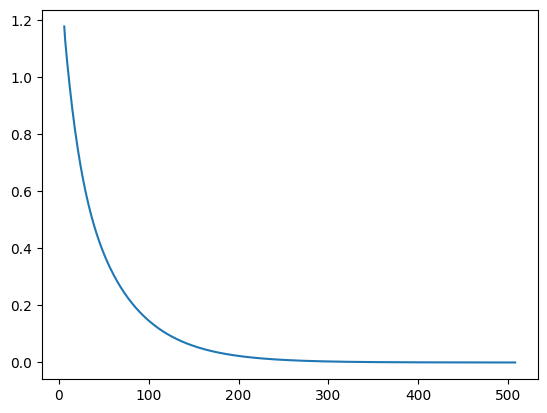

In [176]:
sum_imbal_list, i_list= animate(geonet_4_25, niter=500, alpha=0.1, frame_stride=100)
plt.clf()
plt.close()
plt.plot(i_list, sum_imbal_list)
plt.show()

Using our optimization algorithm, we can be almost certain that a geodesic net with 4 boundary vertices and 25 balanced vertices exists. Now we need to derive key properties in order to find the analytical solution